#Imports & Downloads

In [ ]:
!pip install emoji

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 433.8/433.8 kB 2.4 MB/s eta 0:00:00


In [ ]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import nltk
import numpy as np
import re
import seaborn as sns
import string
import emoji
from collections import Counter

from imblearn.combine import SMOTETomek
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

from nltk.corpus import stopwords
from nltk.stem import PorterStemmer, WordNetLemmatizer

from sklearn.decomposition import LatentDirichletAllocation
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.naive_bayes import MultinomialNB, BernoulliNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression


In [ ]:
# Download necessary NLTK resources
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

# Data Preperation


## Loading and Combining the Data

In [ ]:
rutgers_data = pd.read_csv('/content/drive/MyDrive/Projects /ML for DS/data/rutgers_submission.csv')
upenn = pd.read_csv('/content/drive/MyDrive/Projects /ML for DS/data/UPenn_submission.csv')

In [ ]:
# rutgers_data a new column to each DataFrame to identify the source
rutgers_data['subreddit'] = 'Rutgers'
upenn['subreddit'] = 'UPenn'

# Combine the datasets
combined_data  = pd.concat([rutgers_data, upenn], ignore_index=True)

In [ ]:
combined_data

,author,title,score,created,link,text,url,subreddit
0,u/MsChanandalerBong,Tuition Rally at Brower,6,2010-04-28 20:11,https://www.reddit.com/r/rutgers/comments/bxhy...,NaN,http://www.dailytargum.com/multimedia/2.12020/...,Rutgers
1,u/MsChanandalerBong,Rutgers Mohamed Sanu for Heisman? More Likely ...,6,2010-04-28 20:22,https://www.reddit.com/r/rutgers/comments/bxi2...,NaN,http://bleacherreport.com/articles/357996-sanu...,Rutgers
2,u/rustoof,So how many of us are here?,18,2010-05-08 16:36,https://www.reddit.com/r/rutgers/comments/c1k7...,"Hi guys/gals,\nI'm gonna be a junior in the fa...",https://www.reddit.com/r/rutgers/comments/c1k7...,Rutgers
3,u/tomatohs,Gov. Chris Christie wants all N.J. medical mar...,11,2010-06-19 12:09,https://www.reddit.com/r/rutgers/comments/cgru...,NaN,http://www.nj.com/news/index.ssf/2010/06/chris...,Rutgers
4,u/thisismypasswordtoo,Setting up DC++ (Windows),9,2010-08-30 20:55,https://www.reddit.com/r/rutgers/comments/d7hl...,(throwaway account)\n\n* you must be on the Ru...,https://www.reddit.com/r/rutgers/comments/d7hl...,Rutgers
...,...,...,...,...,...,...,...,...
151909,u/softalmondmilk,SUPPLEMENTAL ESSAY,1,2022-12-31 03:56,https://www.reddit.com/r/UPenn/comments/zzpsgn...,[removed],https://www.reddit.com/r/UPenn/comments/zzpsgn...,UPenn
151910,u/softalmondmilk,ISP and BFS,3,2022-12-31 10:13,https://www.reddit.com/r/UPenn/comments/zzw6fa...,I was hoping to know if ISP is still offered f...,https://www.reddit.com/r/UPenn/comments/zzw6fa...,UPenn
151911,u/[deleted],Is my schedule too much work?,1,2022-12-31 12:47,https://www.reddit.com/r/UPenn/comments/zzzhvj...,[deleted],NaN,UPenn
151912,u/itsamayzing,Does anyone know what topics are covered in ST...,5,2022-12-31 16:24,https://www.reddit.com/r/UPenn/comments/100425...,Going straight into stat 1020 because I had a ...,https://www.reddit.com/r/UPenn/comments/100425...,UPenn


In [ ]:
combined_data.to_csv('/content/drive/MyDrive/Projects /ML for DS/data/combined_data.csv', index = True)

# Exploratory Data Analysis (EDA)

## Statistics

In [ ]:
print(combined_data.head())
print('\n\n\n##########################################\n\n')
#  general information about the dataset
combined_data.info(), combined_data.head()
print('\n\n\n##########################################\n\n')
combined_data.describe()

                  author                                              title  \
0    u/MsChanandalerBong                            Tuition Rally at Brower   
1    u/MsChanandalerBong  Rutgers Mohamed Sanu for Heisman? More Likely ...   
2              u/rustoof                        So how many of us are here?   
3             u/tomatohs  Gov. Chris Christie wants all N.J. medical mar...   
4  u/thisismypasswordtoo                          Setting up DC++ (Windows)   

   score           created                                               link  \
0      6  2010-04-28 20:11  https://www.reddit.com/r/rutgers/comments/bxhy...   
1      6  2010-04-28 20:22  https://www.reddit.com/r/rutgers/comments/bxi2...   
2     18  2010-05-08 16:36  https://www.reddit.com/r/rutgers/comments/c1k7...   
3     11  2010-06-19 12:09  https://www.reddit.com/r/rutgers/comments/cgru...   
4      9  2010-08-30 20:55  https://www.reddit.com/r/rutgers/comments/d7hl...   

                                      

,score
count,151914.00000
mean,15.18159
std,50.03704
min,0.00000
25%,1.00000
50%,3.00000
75%,7.00000
max,1782.00000


In [ ]:
combined_data.isnull().sum()

author           0
title            0
score            0
created          0
link             0
text         22295
url           2132
subreddit        0
dtype: int64

Columns Description:
1. Unnamed: 0: This appears to be an index column.
2. author: The username of the post author.
3. title: The title of the post.
4. score: The net upvotes minus downvotes the post received.
5. created: The date and time when the post was created.
6. link: A link associated with the post.
7. text: The text content of the post.
8. url: The URL provided in the post, if any.
9. subreddit: This field is intended to denote the subreddit.

sine the Created column is in object format lets change it to Date Time Format:

In [ ]:
combined_data['created'] = pd.to_datetime(combined_data['created'], errors='coerce', format='%Y-%m-%d %H:%M')

Lets plot the number of posts and its timeline of posting for both the subreddit:

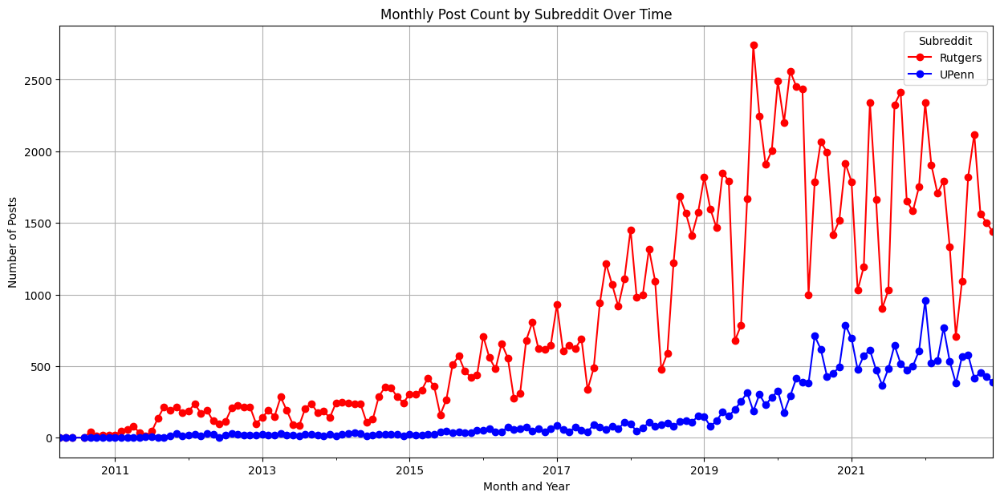

(Timestamp('2010-04-28 20:11:00'),
 Timestamp('2022-12-31 18:50:00'),
 subreddit
 Rutgers    127207
 UPenn       24707
 Name: count, dtype: int64)

In [ ]:
import matplotlib.pyplot as plt

# Check the start and end date for the dataset to understand the period covered
start_date = combined_data['created'].min()
end_date = combined_data['created'].max()

# Count the number of posts per subreddit to check for imbalance
subreddit_counts = combined_data['subreddit'].value_counts()

# Create a time series plot of the number of posts by month and subreddit
combined_data['month_year'] = combined_data['created'].dt.to_period('M')
posts_per_month = combined_data.groupby(['month_year', 'subreddit']).size().unstack(fill_value=0)

# Define colors for each subreddit
colors = {'Rutgers': 'red', 'UPenn': 'blue'}
# Ensure there are colors assigned for all possible subreddits
default_color = 'gray'  # Any subreddit not specified will be plotted in gray
subreddit_colors = [colors.get(x, default_color) for x in posts_per_month.columns]

# Plot the data
plt.figure(figsize=(15, 7))
posts_per_month.plot(kind='line', marker='o', color=subreddit_colors, ax=plt.gca())
plt.title('Monthly Post Count by Subreddit Over Time')
plt.xlabel('Month and Year')
plt.ylabel('Number of Posts')
plt.grid(True)
plt.legend(title='Subreddit')
plt.show()

# Display the start and end dates and the counts of posts per subreddit
start_date, end_date, subreddit_counts

**Dataset Time Range**
* Start Date: July 27, 2008
* End Date: December 31, 2022

This wide range offers a comprehensive look at the subreddit activity over 14 years, capturing trends across different periods.

**Subreddit Post Counts**
* Rutgers: 127,207 posts
* UPenn: 24,707 posts

The dataset is significantly imbalanced with a higher number of posts from the Rutgers subreddit compared to UPenn. This imbalance should be considered when modeling to prevent bias toward the more represented class.

If u notice our data is actually following a cyclical pattern so lets explore that by just considering the last year of our dataset (2021-2022) and plot this data to know the distribution of the posts according to the months

<ipython-input-13-b81a22ec4e05>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data['month'] = filtered_data['created'].dt.month


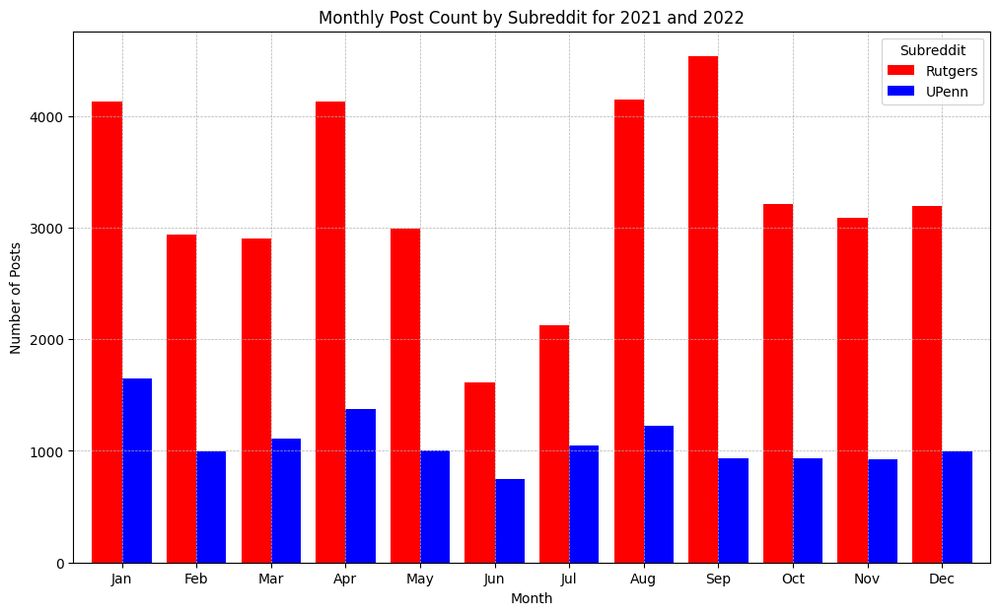

In [ ]:
# Filter the data for the years 2021 and 2022
filtered_data = combined_data[combined_data['created'].dt.year.isin([2021, 2022])]

# Create a time series plot of the number of posts by month for 2021 and 2022
filtered_data['month'] = filtered_data['created'].dt.month
posts_per_month_recent = filtered_data.groupby(['month', 'subreddit']).size().unstack(fill_value=0)

# Plot the data
plt.figure(figsize=(12, 7))
posts_per_month_recent.plot(kind='bar', ax=plt.gca(), width=0.8,color=subreddit_colors)
plt.title('Monthly Post Count by Subreddit for 2021 and 2022')
plt.xlabel('Month')
plt.ylabel('Number of Posts')
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend(title='Subreddit')
plt.xticks(ticks=range(12), labels=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'], rotation=0)
plt.show()

As we see there is a cyclical nature to the posts made by people duing the academic year especially peaking when the semester starts and then again during exam season as well.

I also wanted to see if the data that we have explains how the students posts throught the day considering that we have also the time of the posting.

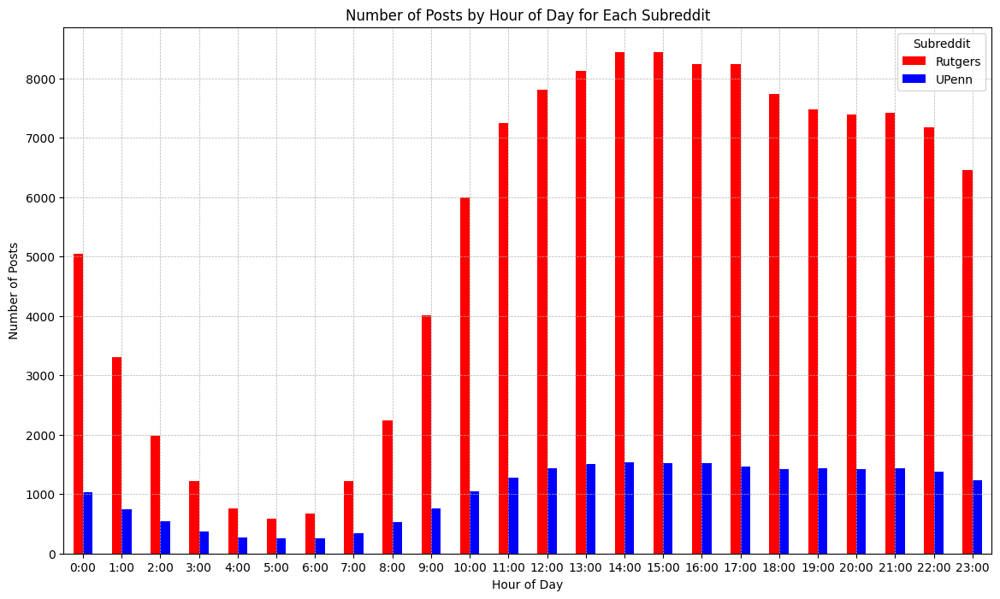

In [ ]:
# Extract the hour of the day from the 'created' datetime column for analysis
combined_data['hour_of_day'] = combined_data['created'].dt.hour

# Group by hour of day and subreddit to see the distribution of posts
posts_per_hour = combined_data.groupby(['hour_of_day', 'subreddit']).size().unstack(fill_value=0)

# Plot the data
plt.figure(figsize=(14, 8))
posts_per_hour.plot(kind='bar', ax=plt.gca(),color=subreddit_colors)
plt.title('Number of Posts by Hour of Day for Each Subreddit')
plt.xlabel('Hour of Day')
plt.ylabel('Number of Posts')
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend(title='Subreddit')
plt.xticks(ticks=range(24), labels=[f"{hour}:00" for hour in range(24)], rotation=0)
plt.show()

Okay slightly off topic but i wanted to see the frequency of the posts through the week as well not just the average of the days so

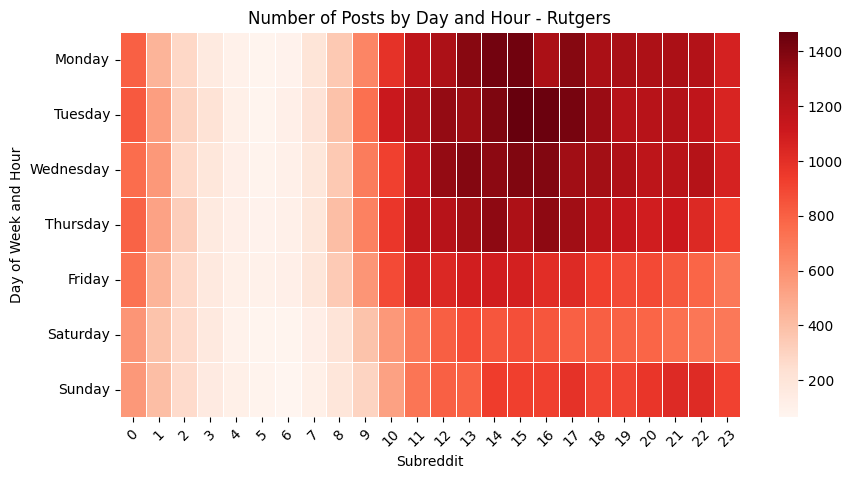

In [ ]:
# Extract the day of the week from the 'created' datetime column for analysis
combined_data['day_of_week'] = combined_data['created'].dt.day_name()

# Group by day of week and hour of day to see the distribution of posts, considering both subreddit categories
posts_per_week_hour = combined_data.groupby(['day_of_week', 'hour_of_day', 'subreddit']).size().unstack(level=-1).unstack(fill_value=0)

# Sort days of the week in the correct order
days_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
posts_per_week_hour = posts_per_week_hour.reindex(days_order)

# Plot the data in a heatmap for better visualization of daily and hourly trends
plt.figure(figsize=(10, 5))
sns.heatmap(posts_per_week_hour['Rutgers'], annot=False, cmap='Reds', linewidths=.5)
plt.title('Number of Posts by Day and Hour - Rutgers')
plt.xlabel('Subreddit')
plt.ylabel('Day of Week and Hour')
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.show()

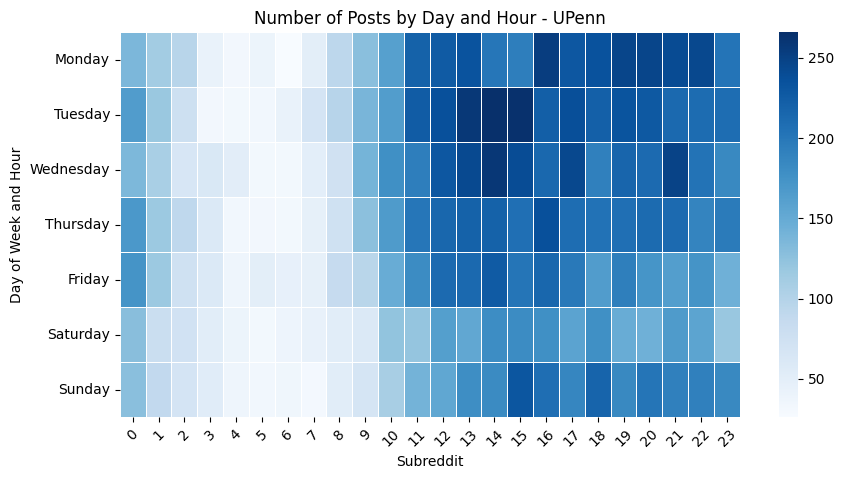

In [ ]:
plt.figure(figsize=(10, 5))
sns.heatmap(posts_per_week_hour['UPenn'], annot=False, cmap='Blues', linewidths=.5)
plt.title('Number of Posts by Day and Hour - UPenn')
plt.xlabel('Subreddit')
plt.ylabel('Day of Week and Hour')
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.show()

##**Heat Maps:**

**Rutgers (Red Heatmap):**

**High Activity:** The evening hours, especially from around 16:00 to 22:00, show higher activity across almost all days, with peak posting during these times on weekdays.

**Weekday vs Weekend**: Activity on weekends is slightly less during the usual peak hours compared to weekdays, but still significant in the late afternoon and evening.

**UPenn (Blue Heatmap):**
**Consistent Patterns:** Similar to Rutgers, the peak times are in the evening from around 16:00 to 22:00 across the week.

**Weekend Trends:** There is a notable drop in activity during early morning hours over the weekend, and slightly less intense activity during evening hours on weekends compared to weekdays.

##**Summary of Posting Trends:**
Both subreddits show similar patterns with peak activity in the evenings, which likely aligns with students' free time post-classes. Mornings show moderate activity, especially on weekdays, possibly before or between morning classes.

Posts length vs Score

Lets try and check the score of the posts to the length of it just to know how if the longer posts have a better score:

In [ ]:
# Recalculate the post length as the number of characters in the text content
combined_data['post_length'] = combined_data['text'].str.len().fillna(0)

In [ ]:
combined_data[['score','post_length']]

,score,post_length
0,6,0.0
1,6,0.0
2,18,99.0
3,11,0.0
4,9,1315.0
...,...,...
151909,1,9.0
151910,3,96.0
151911,1,9.0
151912,5,210.0


since the length varies a lot we will be using a log scale to plot this scatter plot

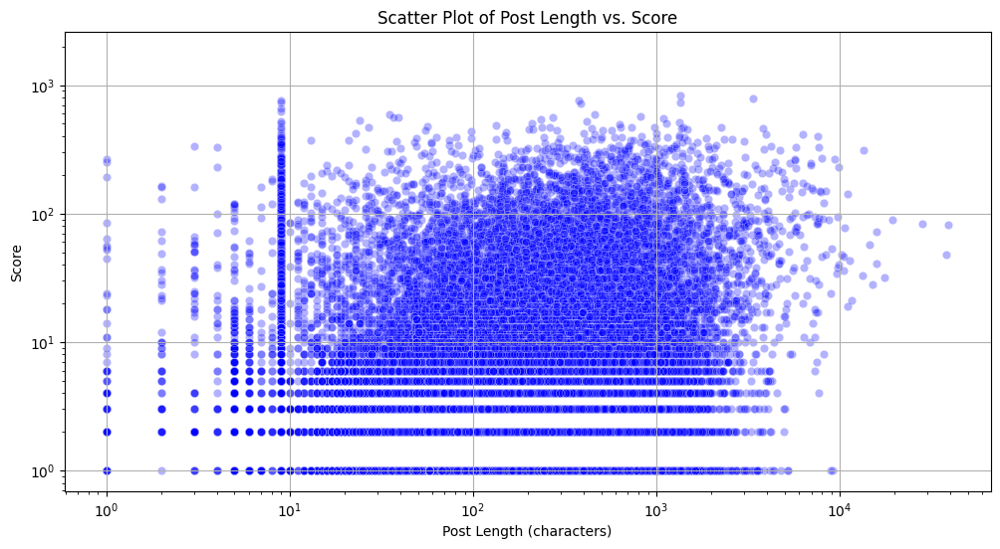

In [ ]:
# Re-plotting the relationship between post length and score
plt.figure(figsize=(12, 6))
sns.scatterplot(x='post_length', y='score', data=combined_data, alpha=0.3, color= 'blue')
plt.title('Scatter Plot of Post Length vs. Score')
plt.xlabel('Post Length (characters)')
plt.ylabel('Score')
plt.xscale('log')  # Log scale for better visualization of a wide range of values
plt.yscale('log')
plt.grid(True)
plt.show()

**Concentration:** Most data points are concentrated in the area representing shorter posts with lower scores, consistent with the bulk of community interactions being on brief, less engaged content.

**Outliers:** There are a few outliers with either very long posts or high scores, indicating exceptional cases where posts either generated substantial interest or were extensive in detail.

In [ ]:
# Re-calculating the correlation coefficient between post length and score
correlation_post_length_score = combined_data['post_length'].corr(combined_data['score'])

# Display the correlation coefficient
correlation_post_length_score

0.01576762917368809

**Correlation Coefficient**
The correlation coefficient between post length and score is approximately 0.01576762917368809

**This indicates:**

**Very Weak Positive Correlation:**

There is almost no linear relationship between the length of a post and the score it receives. This weak correlation suggests that longer posts do not necessarily equate to higher engagement, measured in terms of scores.

lets also view these plots individually to check if the skewedness of the plots

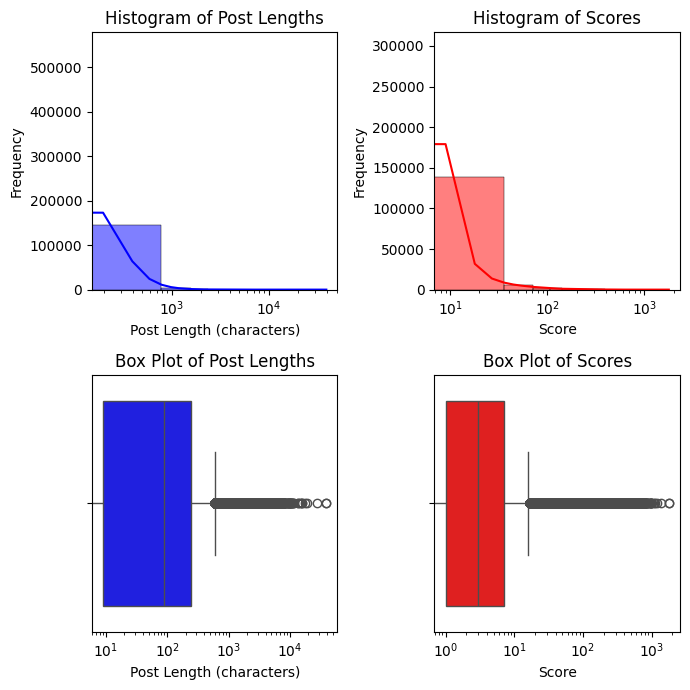

In [ ]:
# Create a combined visualization for both histograms and box plots for post lengths and scores
fig, axs = plt.subplots(2, 2, figsize=(7, 7))

# Histogram for Post Length
sns.histplot(combined_data['post_length'], bins=50, ax=axs[0, 0], kde=True, color='blue')
axs[0, 0].set_title('Histogram of Post Lengths')
axs[0, 0].set_xlabel('Post Length (characters)')
axs[0, 0].set_ylabel('Frequency')
axs[0, 0].set_xscale('log')  # Logarithmic scale to better visualize the data

# Histogram for Scores
sns.histplot(combined_data['score'], bins=50, ax=axs[0, 1], kde=True, color='red')
axs[0, 1].set_title('Histogram of Scores')
axs[0, 1].set_xlabel('Score')
axs[0, 1].set_ylabel('Frequency')
axs[0, 1].set_xscale('log')  # Logarithmic scale to manage the skew in scores

# Box plot for Post Length
sns.boxplot(x=combined_data['post_length'], ax=axs[1, 0], color='blue')
axs[1, 0].set_title('Box Plot of Post Lengths')
axs[1, 0].set_xlabel('Post Length (characters)')
axs[1, 0].set_xscale('log')  # Logarithmic scale to better visualize the data

# Box plot for Scores
sns.boxplot(x=combined_data['score'], ax=axs[1, 1], color='red')
axs[1, 1].set_title('Box Plot of Scores')
axs[1, 1].set_xlabel('Score')
axs[1, 1].set_xscale('log')  # Logarithmic scale to manage the skew in scores

plt.tight_layout()
plt.show()

In [ ]:
score_length = combined_data[['score', 'post_length']]

score_length.describe()

,score,post_length
count,151914.00000,151914.000000
mean,15.18159,187.564589
std,50.03704,406.691776
min,0.00000,0.000000
25%,1.00000,9.000000
50%,3.00000,87.000000
75%,7.00000,243.000000
max,1782.00000,39229.000000


In [ ]:
# Find the post with the largest score
max_score_post = combined_data.loc[combined_data['score'].idxmax()]

# Find the post with the largest post length
max_length_post = combined_data.loc[combined_data['post_length'].idxmax()]

# Display the posts
print("Post with the largest score:")
print(max_score_post)
print("\nPost with the largest length:")
print(max_length_post)

Post with the largest score:
author                                           u/kingvincent25
title          Guys, I need your help. I need to create a sub...
score                                                       1782
created                                      2020-12-14 10:24:00
link           https://www.reddit.com/r/rutgers/comments/kczm...
text                                                         NaN
url            https://www.reddit.com/r/rutgers/comments/kczm...
subreddit                                                Rutgers
month_year                                               2020-12
hour_of_day                                                   10
day_of_week                                               Monday
post_length                                                  0.0
Name: 87262, dtype: object

Post with the largest length:
author                                          u/alphacentauri3
title          Review of Rutgers CS - Part 1: My journey and ...
sco

In [ ]:
# Adjust display settings in Pandas
pd.set_option('display.max_colwidth', 999999999)

# Find the post with the largest score
max_score_post = combined_data.loc[combined_data['score'].idxmax()]

# Find the post with the largest post length
max_length_post = combined_data.loc[combined_data['post_length'].idxmax()]

# Display the posts
print("Post with the largest score:")
print(max_score_post.to_string())
print("\n\nPost with the largest length:")
print(max_length_post.to_string())

Post with the largest score:
author                                                                                                                                                                                    u/kingvincent25
title          Guys, I need your help. I need to create a subreddit for a class as a final project but I don’t have enough karma to create one. Can you guys please upvote this so I can finish my final!
score                                                                                                                                                                                                1782
created                                                                                                                                                                               2020-12-14 10:24:00
link                                                                                                           https://www.reddit.com/r/rutgers/comments/kczmwd/guy

## Data Cleaning

In [ ]:
combined_data.head(3)

,author,title,score,created,link,text,url,subreddit,month_year,hour_of_day,day_of_week,post_length
0,u/MsChanandalerBong,Tuition Rally at Brower,6,2010-04-28 20:11:00,https://www.reddit.com/r/rutgers/comments/bxhyh/tuition_rally_at_brower/,NaN,http://www.dailytargum.com/multimedia/2.12020/tuition-rally-1.2236405,Rutgers,2010-04,20,Wednesday,0.0
1,u/MsChanandalerBong,Rutgers Mohamed Sanu for Heisman? More Likely In 2011,6,2010-04-28 20:22:00,https://www.reddit.com/r/rutgers/comments/bxi2v/rutgers_mohamed_sanu_for_heisman_more_likely_in/,NaN,http://bleacherreport.com/articles/357996-sanu-for-heisman-how-about-2011,Rutgers,2010-04,20,Wednesday,0.0
2,u/rustoof,So how many of us are here?,18,2010-05-08 16:36:00,https://www.reddit.com/r/rutgers/comments/c1k70/so_how_many_of_us_are_here/,"Hi guys/gals,\nI'm gonna be a junior in the fall in accounting and live on stone st.\nWhat about you?",https://www.reddit.com/r/rutgers/comments/c1k70/so_how_many_of_us_are_here/,Rutgers,2010-05,16,Saturday,99.0


for our analysis since dealing with texts we will focus on the title and subreddit col only.

In [ ]:
df = combined_data[['title','subreddit']]
df

,title,subreddit
0,Tuition Rally at Brower,Rutgers
1,Rutgers Mohamed Sanu for Heisman? More Likely In 2011,Rutgers
2,So how many of us are here?,Rutgers
3,Gov. Chris Christie wants all N.J. medical marijuana grown at Rutgers,Rutgers
4,Setting up DC++ (Windows),Rutgers
...,...,...
151909,SUPPLEMENTAL ESSAY,UPenn
151910,ISP and BFS,UPenn
151911,Is my schedule too much work?,UPenn
151912,Does anyone know what topics are covered in STAT 1010?,UPenn


### **Text Cleaning**

In [ ]:
def Text_Cleaning(Text):
    # Remove emojis using the emoji package
    Text = emoji.replace_emoji(Text, replace='')

    # Remove URLs
    Text = re.sub(r'https?://\S+|www\.\S+', '', Text)

    # Remove newlines and tabs
    Text = re.sub(r'[\t\n\r]+', ' ', Text)

    # Remove punctuations
    punc_table = str.maketrans('', '', string.punctuation)
    Text = Text.translate(punc_table)

    # Remove non-ASCII characters
    Text = Text.encode("ascii", errors="ignore").decode()

    # Remove numbers and words with numbers
    Text = re.sub(r'\w*\d\w*', '', Text)

    # Remove single characters
    Text = re.sub(r'\s+[a-zA-Z]\s+', ' ', Text)
    return Text


### **Text Processing**

In [ ]:
# Stopwords
Stopwords = set(nltk.corpus.stopwords.words("english")) - set(["not"])

def Text_Processing(Text):
  Processed_Text = list()
  Lemmatizer = WordNetLemmatizer()

  # Tokens of Words
  Tokens = nltk.word_tokenize(Text)

  # Removing Stopwords and Lemmatizing Words
  # I am keeping the not for future use incase we plan on running a sentiment analysis model on this data.
  for word in Tokens:
    if word not in Stopwords:
      Processed_Text.append(Lemmatizer.lemmatize(word))

  return(" ".join(Processed_Text))

In [ ]:
df['cleaned_title'] = df['title'].apply(Text_Cleaning)
df['processed_title'] = df['cleaned_title'].apply(Text_Processing)
df

<ipython-input-29-b3fec695295a>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['cleaned_title'] = df['title'].apply(Text_Cleaning)
<ipython-input-29-b3fec695295a>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['processed_title'] = df['cleaned_title'].apply(Text_Processing)


,title,subreddit,cleaned_title,processed_title
0,Tuition Rally at Brower,Rutgers,Tuition Rally at Brower,Tuition Rally Brower
1,Rutgers Mohamed Sanu for Heisman? More Likely In 2011,Rutgers,Rutgers Mohamed Sanu for Heisman More Likely In,Rutgers Mohamed Sanu Heisman More Likely In
2,So how many of us are here?,Rutgers,So how many of us are here,So many u
3,Gov. Chris Christie wants all N.J. medical marijuana grown at Rutgers,Rutgers,Gov Chris Christie wants all NJ medical marijuana grown at Rutgers,Gov Chris Christie want NJ medical marijuana grown Rutgers
4,Setting up DC++ (Windows),Rutgers,Setting up DC Windows,Setting DC Windows
...,...,...,...,...
151909,SUPPLEMENTAL ESSAY,UPenn,SUPPLEMENTAL ESSAY,SUPPLEMENTAL ESSAY
151910,ISP and BFS,UPenn,ISP and BFS,ISP BFS
151911,Is my schedule too much work?,UPenn,Is my schedule too much work,Is schedule much work
151912,Does anyone know what topics are covered in STAT 1010?,UPenn,Does anyone know what topics are covered in STAT,Does anyone know topic covered STAT


In [ ]:
df = df[df['processed_title'] != 'deleted user']
df = df[df['processed_title'].str.strip() != '']

We also had to get rif of emojis and also some of the random spam comments as well in Korean etc.



In [ ]:
df.value_counts('processed_title')

processed_title
Calc                                                                       102
Housing                                                                     92
Math                                                                        82
CIS                                                                         53
Chem                                                                        53
                                                                          ... 
Hey Penn international applicant Scotland considering applying Can help      1
Hey Penn engineer cool program unique opportunity                            1
Hey Penn GODS admission interview scheduled day need guidance                1
Hey Orgo tutor                                                               1
zoomin thrivin                                                               1
Name: count, Length: 135109, dtype: int64

Now finally our data for title is clean without any emojis or having multilingual characters.

In [ ]:
df.drop(columns=['cleaned_title', 'title'])

,subreddit,processed_title
0,Rutgers,Tuition Rally Brower
1,Rutgers,Rutgers Mohamed Sanu Heisman More Likely In
2,Rutgers,So many u
3,Rutgers,Gov Chris Christie want NJ medical marijuana grown Rutgers
4,Rutgers,Setting DC Windows
...,...,...
151909,UPenn,SUPPLEMENTAL ESSAY
151910,UPenn,ISP BFS
151911,UPenn,Is schedule much work
151912,UPenn,Does anyone know topic covered STAT


##Text Analysis

### N-Gram Analysis

In [ ]:
def gram_analysis(corpus, n_gram, top_n):
    vectorizer = CountVectorizer(stop_words='english', ngram_range=(n_gram, n_gram))
    ngrams = vectorizer.fit_transform(corpus)
    count_values = ngrams.toarray().sum(axis=0)

    # Get n-gram feature names and count values
    vocab = vectorizer.get_feature_names_out()
    data = {'ngram': vocab, 'count': count_values}
    ngram_df = pd.DataFrame(data).sort_values('count', ascending=False).head(top_n)

    return ngram_df

In [ ]:
def plot_ngrams(ngram_df, title,color):
    ngram_df.sort_values('count').plot.barh(x='ngram', y='count', color=color, figsize=(10, 8))
    plt.title(title)
    plt.xlabel('Frequency')
    plt.ylabel('N-grams')
    plt.show()

#### Unigram, Bigram and Trigram for Rutgers

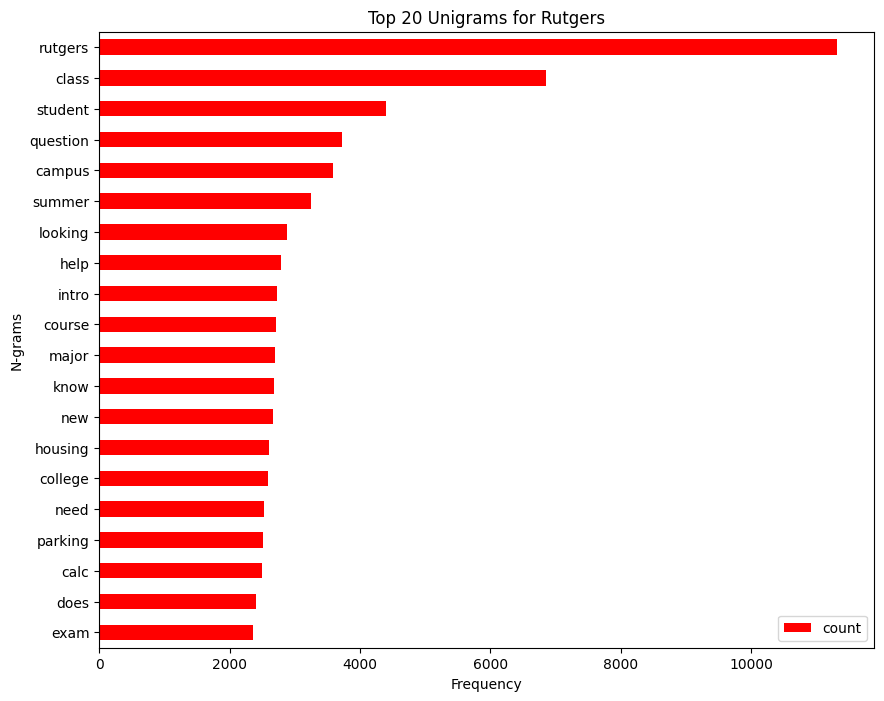

In [ ]:
# Perform N-Gram Analysis for Rutgers
rutgers_titles = df[df['subreddit'] == 'Rutgers']['processed_title'].dropna()
rutgers_unigram_df = gram_analysis(rutgers_titles, 1, 20)
plot_ngrams(rutgers_unigram_df, 'Top 20 Unigrams for Rutgers', 'red')

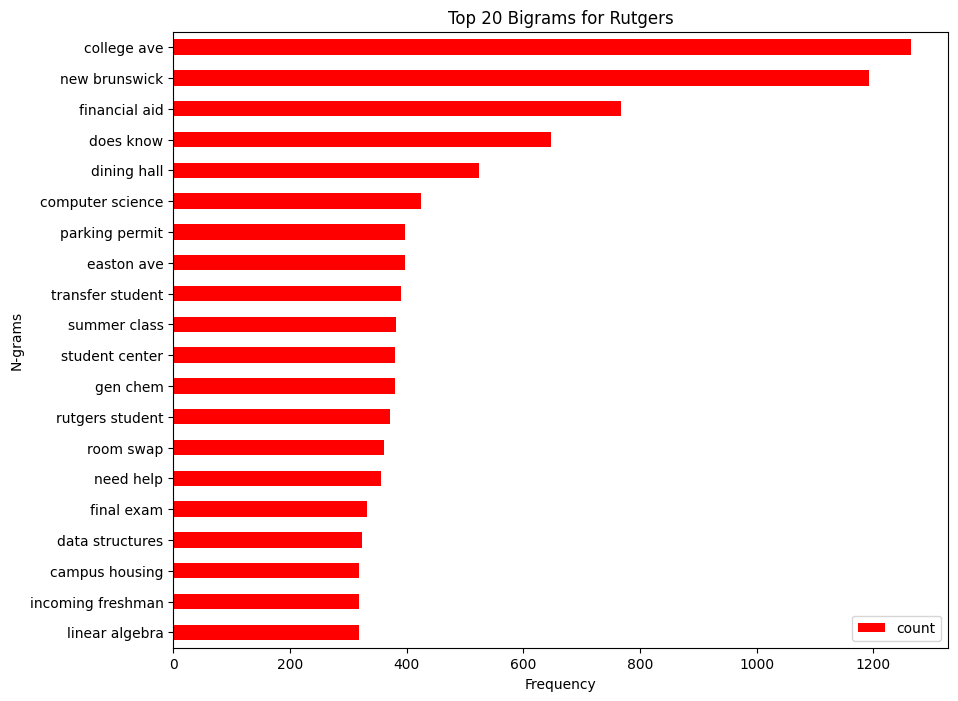

In [ ]:
rutgers_bigram_df = gram_analysis(rutgers_titles, 2, 20)
plot_ngrams(rutgers_bigram_df, 'Top 20 Bigrams for Rutgers', 'red')

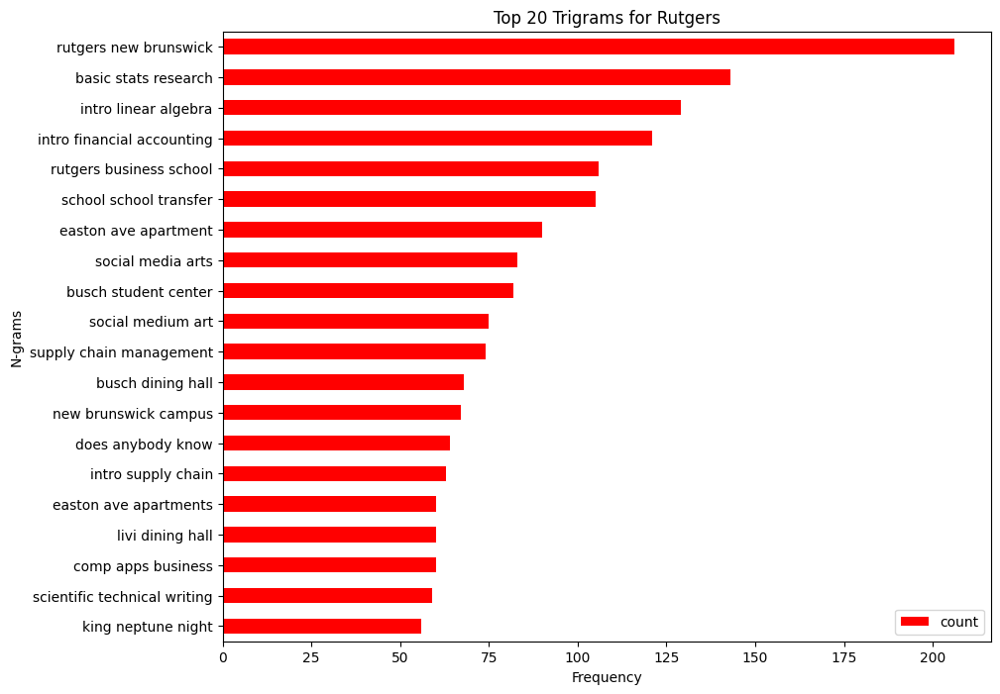

In [ ]:
rutgers_trigram_df = gram_analysis(rutgers_titles, 3, 20)
plot_ngrams(rutgers_trigram_df, 'Top 20 Trigrams for Rutgers', 'red')

#### Unigram, BIgram , Traigram for UPenn

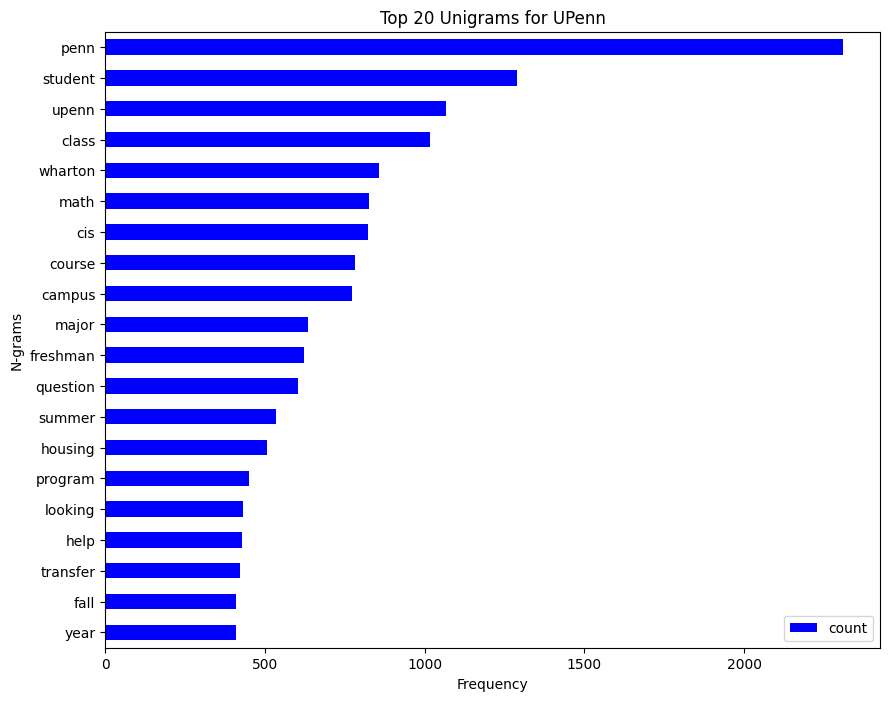

In [ ]:
# Perform N-Gram Analysis for UPenn
upenn_titles = df[df['subreddit'] == 'UPenn']['processed_title'].dropna()
upenn_unigram_df = gram_analysis(upenn_titles, 1, 20)
plot_ngrams(upenn_unigram_df, 'Top 20 Unigrams for UPenn', 'blue')

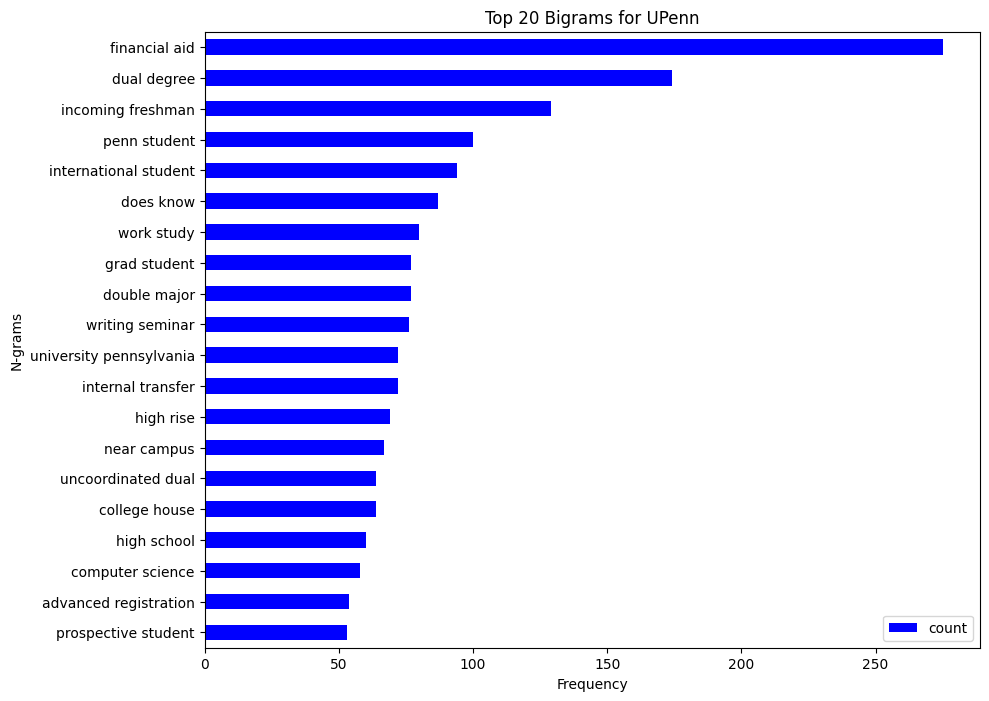

In [ ]:
upenn_bigram_df = gram_analysis(upenn_titles, 2, 20)
plot_ngrams(upenn_bigram_df, 'Top 20 Bigrams for UPenn', 'blue')

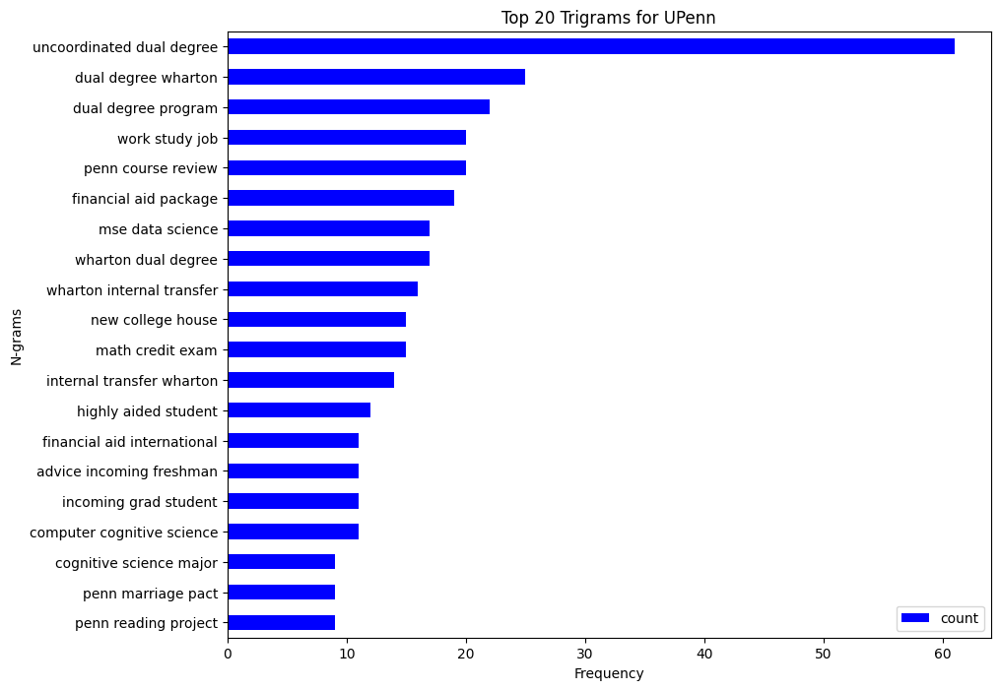

In [ ]:
upenn_trigram_df = gram_analysis(upenn_titles, 3, 20)
plot_ngrams(upenn_trigram_df, 'Top 20 Trigrams for UPenn', 'blue')

### Word Cloud

#### Word Cloud for Rutgers

In [ ]:
#  WordCloud for Rutgers
rutgers_titles = ' '.join(df[df['subreddit'] == 'Rutgers']['processed_title'].dropna())
rutgers_wordcloud = WordCloud(
    max_words=50,
    width=3000,
    height=1500,
    stopwords=Stopwords,
    background_color="white",
    colormap="Reds"
).generate(rutgers_titles)

(-0.5, 2999.5, 1499.5, -0.5)

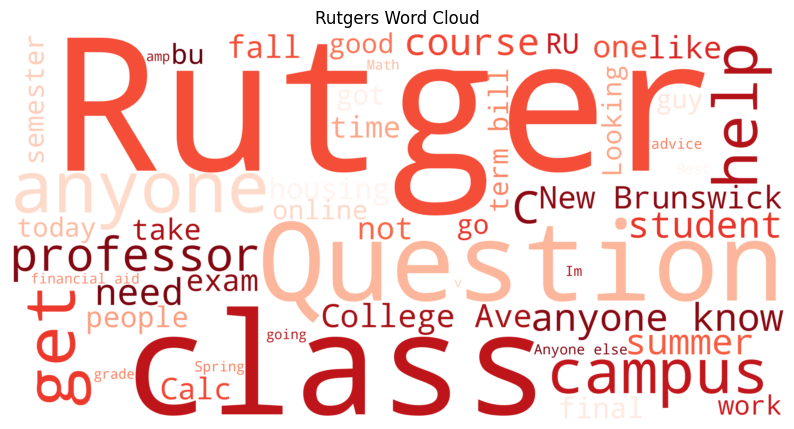

In [ ]:
# Visualize the word clouds
plt.figure(figsize=(10, 10))
plt.imshow(rutgers_wordcloud, interpolation='bilinear')
plt.title('Rutgers Word Cloud')
plt.axis('off')

#### Word Cloud for UPenn

In [ ]:
upenn_titles = ' '.join(df[df['subreddit'] == 'UPenn']['processed_title'].dropna())
upenn_wordcloud = WordCloud(
    max_words=50,
    width=3000,
    height=1500,
    stopwords=Stopwords,
    background_color="white",
    colormap="Blues"
).generate(upenn_titles)

(-0.5, 2999.5, 1499.5, -0.5)

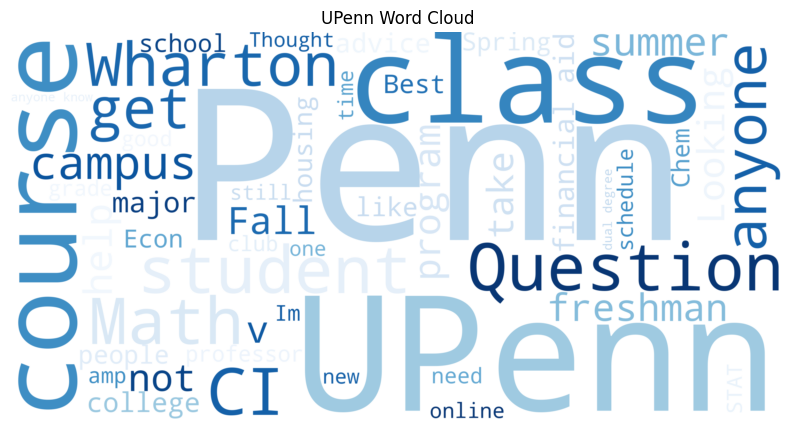

In [ ]:
plt.figure(figsize=(10, 10))
plt.imshow(upenn_wordcloud, interpolation='bilinear')
plt.title('UPenn Word Cloud')
plt.axis('off')

### Word2Vec

Lets create a Word 2 Vec model just to see how our text relates to each other and understand similarities and other characters.

In [ ]:
#regular imports
import pandas as pd
import matplotlib.pyplot as plt
import datetime as dt

#gensim imports
import re
import gensim
from gensim.models import LdaModel
from gensim.corpora import Dictionary
from gensim.models import CoherenceModel
from gensim import corpora
from collections import defaultdict



# ntlk imports
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer

In [ ]:
#http://www.nltk.org/_modules/nltk/tokenize/punkt.html
nltk.download('punkt')
#Wordnet is important for Lemmatization ==> seel later when we dig into this
#https://www.nltk.org/howto/wordnet.html
nltk.download('wordnet')
#use nltk to get stopwords
nltk.download('stopwords')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [ ]:
#create a stoplist that includes all the english stop words
stopwords_english = stopwords.words('english')
display('here is a subset of the stop words')
display(stopwords_english[0:10])

# Text Cleaning
import string

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings(action='ignore',category=UserWarning,module='gensim')
warnings.filterwarnings(action='ignore',category=FutureWarning,module='gensim')

'here is a subset of the stop words'

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're"]

In [ ]:
#nltk lemmatizer
from nltk.stem import WordNetLemmatizer
wordnet_lemmatizer = WordNetLemmatizer()

Doing the whole clean pass just for this section to run through

In [ ]:
#creating the same clean pass function
def clean_pass(text):
    #make string lowercase
    text = str(text)
    text = text.lower()

    #tokenize
    #create bag of words
    #1-grams
    tokens = nltk.word_tokenize(text)
    clean_text = []

    #remove stopwords, puncuation, then lemmatize
    for word in tokens:
        if (word not in stopwords_english and word not in string.punctuation):
            token = wordnet_lemmatizer.lemmatize(word)
            clean_text.append(token)

    #remove words of length 3 or smaller
    clean_text = [token for token in clean_text if len(token) > 2]

    return clean_text

In [ ]:
df['processed_title'] = df.processed_title.apply(clean_pass)

df.processed_title

0                                                 [tuition, rally, brower]
1                                [rutgers, mohamed, sanu, heisman, likely]
2                                                                   [many]
3         [gov, chris, christie, want, medical, marijuana, grown, rutgers]
4                                                        [setting, window]
                                        ...                               
151909                                               [supplemental, essay]
151910                                                          [isp, bfs]
151911                                              [schedule, much, work]
151912                                [anyone, know, topic, covered, stat]
151913                        [anyone, use, university, hsa, health, plan]
Name: processed_title, Length: 148284, dtype: object

In [ ]:
'''
Parameters:
**********
**********

min_count: tells word2vec to ignore rare words. These are words with lower frequency compared to the specified value.

size: This is the size of the hidden layer which, in turn, determines the size of the word
embedding vector. Defaults to 100. You might think that more neurons might capture more nuances,
but beyond a certain point (higher with the amount of training data) there might be too much noise
coming down from their initial state. And of course training time and resources will grow as size grows.

window: gives the width of the context: how many surrounding words to consider.

workers:Use these many worker threads to train the model (=faster training with multicore machines). The more cores you
are using, the faster the model will be trained.
'''

from gensim.models import Word2Vec
model = Word2Vec(df.processed_title.values, min_count=5,vector_size=300,workers=6, window=5)

In [ ]:
model.wv.most_similar('rutgers', topn=10)  # get other similar words

[('penn', 0.786194920539856),
 ('pennsylvania', 0.7065936923027039),
 ('upenn', 0.7005419731140137),
 ('university', 0.6738671064376831),
 ('president', 0.6610144376754761),
 ('report', 0.6430330872535706),
 ('faculty', 0.6281049847602844),
 ('coronavirus', 0.6253470182418823),
 ('minecraft', 0.6171616911888123),
 ('rowan', 0.6158574819564819)]

In [ ]:
model.wv.most_similar('upenn', topn=10)  # get other similar words

[('penn', 0.8254845142364502),
 ('mampt', 0.7774819135665894),
 ('competitive', 0.7641792297363281),
 ('future', 0.7527706623077393),
 ('current', 0.7508677244186401),
 ('alumnus', 0.7437769770622253),
 ('internally', 0.7241896986961365),
 ('program', 0.7209224104881287),
 ('wharton', 0.7206037640571594),
 ('disadvantage', 0.7199550271034241)]

In [ ]:
model.wv.most_similar('engineering', topn=10)  # get other similar words

[('ece', 0.8125659823417664),
 ('engineer', 0.8082711100578308),
 ('electrical', 0.7975595593452454),
 ('aerospace', 0.7937502861022949),
 ('pursuing', 0.7688309550285339),
 ('dual', 0.7677013278007507),
 ('sea', 0.7645439505577087),
 ('premed', 0.7547776103019714),
 ('chemical', 0.7431096434593201),
 ('majoring', 0.7402788996696472)]

In [ ]:
model.wv.most_similar('covid', topn=10)  # get other similar words

[('vaccine', 0.8242006301879883),
 ('result', 0.804023802280426),
 ('coronavirus', 0.794784665107727),
 ('positive', 0.7930689454078674),
 ('saliva', 0.79248046875),
 ('testing', 0.7795373797416687),
 ('pcr', 0.7591186165809631),
 ('emergency', 0.7534778118133545),
 ('tested', 0.7283697724342346),
 ('notification', 0.725772500038147)]

In [ ]:
model.wv.most_similar('bus', topn=10)  # get other similar words

[('rexl', 0.7166321277618408),
 ('route', 0.7039956450462341),
 ('driver', 0.678815484046936),
 ('stop', 0.6773924231529236),
 ('rexb', 0.6703084111213684),
 ('running', 0.6627610325813293),
 ('line', 0.6497265696525574),
 ('seat', 0.6396684050559998),
 ('always', 0.6393812298774719),
 ('shuttle', 0.6383252739906311)]

Lets do the similarity comparison

In [ ]:
model.wv.similarity('rutgers','upenn')

0.7005419

In [ ]:
model.wv.similarity('rutgers','ivy')

0.6040357

In [ ]:
model.wv.similarity('bus','late')

0.16022818

What about dissimilar

In [ ]:
model.wv.doesnt_match(['upenn','ivy','rutgers'])

'ivy'

This was generally odd for me to understand most probably its because they both have more in common than just UPenn being ivy.

In [ ]:
model.wv.doesnt_match(['rutgers','loan','job'])

'rutgers'

Lets do a small analogy just to see what we have finally and then move ahead to present the model.

In [ ]:
model.wv.most_similar(positive=["rutgers", "college"], negative=["bus"], topn=10)

[('penn', 0.6527738571166992),
 ('upenn', 0.629334032535553),
 ('program', 0.5822675824165344),
 ('livinglearning', 0.5437331199645996),
 ('international', 0.5296425223350525),
 ('worth', 0.47861766815185547),
 ('current', 0.4780571758747101),
 ('bsn', 0.46685001254081726),
 ('admitted', 0.45771241188049316),
 ('gross', 0.45763400197029114)]

In [ ]:
model.wv.most_similar(positive=["exam", "education"], negative=["college"], topn=10)

[('grading', 0.698756992816925),
 ('analysis', 0.6896274089813232),
 ('syllabus', 0.6876133680343628),
 ('homework', 0.680264949798584),
 ('david', 0.6794846653938293),
 ('numerical', 0.6786759495735168),
 ('hardware', 0.6785872578620911),
 ('fundamental', 0.6760514378547668),
 ('murphy', 0.671870231628418),
 ('planet', 0.6624414920806885)]

####Analyzing Similarities and Differences

In [ ]:
# Most Similar Words
print("Words most similar to 'rutgers':\n", model.wv.most_similar('rutgers', topn=10))

Words most similar to 'rutgers':
 [('penn', 0.786194920539856), ('pennsylvania', 0.7065936923027039), ('upenn', 0.7005419731140137), ('university', 0.6738671064376831), ('president', 0.6610144376754761), ('report', 0.6430330872535706), ('faculty', 0.6281049847602844), ('coronavirus', 0.6253470182418823), ('minecraft', 0.6171616911888123), ('rowan', 0.6158574819564819)]


In [ ]:
print("Words most similar to 'upenn':\n", model.wv.most_similar('upenn', topn=10))

Words most similar to 'upenn':
 [('penn', 0.8254845142364502), ('mampt', 0.7774819135665894), ('competitive', 0.7641792297363281), ('future', 0.7527706623077393), ('current', 0.7508677244186401), ('alumnus', 0.7437769770622253), ('internally', 0.7241896986961365), ('program', 0.7209224104881287), ('wharton', 0.7206037640571594), ('disadvantage', 0.7199550271034241)]


In [ ]:
# Similarity Scores
print("Similarity score between 'rutgers' and 'upenn':", model.wv.similarity('rutgers', 'upenn'))

Similarity score between 'rutgers' and 'upenn': 0.7005419


In [ ]:
print("Similarity score between 'rutgers' and 'ivy':", model.wv.similarity('rutgers', 'ivy'))

Similarity score between 'rutgers' and 'ivy': 0.6040357


In [ ]:
# Odd-One-Out Analysis
print("Odd one out for ['upenn', 'ivy', 'rutgers']:", model.wv.doesnt_match(['upenn', 'ivy', 'rutgers']))

Odd one out for ['upenn', 'ivy', 'rutgers']: ivy


In [ ]:
print("Odd one out for ['rutgers', 'loan', 'job']:", model.wv.doesnt_match(['rutgers', 'loan', 'job']))

Odd one out for ['rutgers', 'loan', 'job']: rutgers


####Performing Analogical Reasoning


In [ ]:
# Analogy Examples
print("Completing the analogy: 'rutgers' is to 'college' as 'X' is to 'bus':\n",
      model.wv.most_similar(positive=['rutgers', 'college'], negative=['bus'], topn=10))

Completing the analogy: 'rutgers' is to 'college' as 'X' is to 'bus':
 [('penn', 0.6527738571166992), ('upenn', 0.629334032535553), ('program', 0.5822675824165344), ('livinglearning', 0.5437331199645996), ('international', 0.5296425223350525), ('worth', 0.47861766815185547), ('current', 0.4780571758747101), ('bsn', 0.46685001254081726), ('admitted', 0.45771241188049316), ('gross', 0.45763400197029114)]


Campus Life vs. Study Balance:

In [ ]:
model.wv.most_similar(positive=['dorm', 'study'], negative=['home'], topn=10)

[('participant', 0.5092398524284363),
 ('learning', 0.4986644685268402),
 ('swap', 0.4971344470977783),
 ('seminar', 0.4758041203022003),
 ('assistant', 0.46448397636413574),
 ('tutor', 0.45459285378456116),
 ('studying', 0.4524478614330292),
 ('tutoring', 0.4449842572212219),
 ('double', 0.4393843412399292),
 ('biology', 0.4374176859855652)]

Undergraduate to Graduate Transition:

In [ ]:
model.wv.most_similar(positive=['graduate', 'undergraduate'], negative=['professor'], topn=10)

[('undergrad', 0.8129611015319824),
 ('nursing', 0.8065541982650757),
 ('applying', 0.7740465998649597),
 ('grad', 0.7657743692398071),
 ('pharmacy', 0.7549444437026978),
 ('current', 0.741146445274353),
 ('soe', 0.7401242852210999),
 ('master', 0.7288368344306946),
 ('sea', 0.720282793045044),
 ('apply', 0.7184532284736633)]

Academic Stress and Relief:


In [ ]:
model.wv.most_similar(positive=['stress', 'relaxation'], negative=['exam'], topn=10)

[('swe', 0.917792797088623),
 ('mayor', 0.9088402390480042),
 ('entrepreneurial', 0.9080362915992737),
 ('colgate', 0.9059432148933411),
 ('son', 0.9042770862579346),
 ('msu', 0.9040341377258301),
 ('worthwhile', 0.9036597609519958),
 ('adp', 0.9029167890548706),
 ('vet', 0.9024874567985535),
 ('robot', 0.9012122750282288)]

Social Life at University:

In [ ]:
model.wv.most_similar(positive=['social', 'university'], negative=['study'], topn=10)

[('president', 0.6435831189155579),
 ('penn', 0.604372501373291),
 ('gross', 0.5971299409866333),
 ('event', 0.580356776714325),
 ('state', 0.5783921480178833),
 ('mason', 0.5744861364364624),
 ('scene', 0.5726431012153625),
 ('coronavirus', 0.5724422335624695),
 ('club', 0.5703215599060059),
 ('pennsylvania', 0.5690468549728394)]

Transition from High School to College:

In [ ]:
model.wv.most_similar(positive=['college', 'highschool'], negative=['job'], topn=10)

[('livinglearning', 0.6982067823410034),
 ('tomorrowworld', 0.6740970611572266),
 ('regular', 0.6600842475891113),
 ('bergen', 0.6512401700019836),
 ('colloquium', 0.645980715751648),
 ('miracle', 0.6221482753753662),
 ('easton', 0.6211614012718201),
 ('church', 0.6209285259246826),
 ('cord', 0.6105048656463623),
 ('blvd', 0.6065792441368103)]

Career Focus vs. Academic Focus:

In [ ]:
model.wv.most_similar(positive=['career', 'education'], negative=['fun'], topn=10)

[('healthcare', 0.7187228202819824),
 ('information', 0.7116981148719788),
 ('master', 0.6934827566146851),
 ('certificate', 0.6678239703178406),
 ('phd', 0.664107620716095),
 ('tech', 0.6639496088027954),
 ('leadership', 0.6598132252693176),
 ('ahmed', 0.6398521065711975),
 ('concentration', 0.63780677318573),
 ('medicine', 0.6344700455665588)]

Impact of Online Learning:


In [ ]:
model.wv.most_similar(positive=['online', 'classroom'], negative=['campus'], topn=10)

[('feigenson', 0.7976371049880981),
 ('bender', 0.7900770902633667),
 ('planet', 0.7805723547935486),
 ('miller', 0.7685720920562744),
 ('synchronous', 0.7587992548942566),
 ('kalef', 0.7567599415779114),
 ('earth', 0.756706714630127),
 ('lepre', 0.7546864151954651),
 ('myth', 0.7528048753738403),
 ('appreciation', 0.7516663074493408)]

Balancing Work and Study:


In [ ]:
model.wv.most_similar(positive=['work', 'study'], negative=['vacation'], topn=10)

[('labor', 0.5876917243003845),
 ('abroad', 0.53315269947052),
 ('guide', 0.513145923614502),
 ('studying', 0.4976927936077118),
 ('opportunity', 0.47777122259140015),
 ('resource', 0.44318392872810364),
 ('learning', 0.4399336576461792),
 ('research', 0.43641868233680725),
 ('done', 0.4348618984222412),
 ('relation', 0.42972394824028015)]

Technology's Role in Education:


In [ ]:
model.wv.most_similar(positive=['technology', 'education'], negative=['textbook'], topn=10)

[('informatics', 0.7492423057556152),
 ('certificate', 0.7130184173583984),
 ('tech', 0.7125326991081238),
 ('analyst', 0.7040334939956665),
 ('security', 0.6996744871139526),
 ('science', 0.6922192573547363),
 ('medicine', 0.6915063261985779),
 ('development', 0.6900174617767334),
 ('entry', 0.685135006904602),
 ('global', 0.6837186217308044)]

Extracurricular Activities' Impact:


In [ ]:
model.wv.most_similar(positive=['extracurricular', 'student'], negative=['class'], topn=10)

[('alumnus', 0.7753589749336243),
 ('philomathean', 0.735614538192749),
 ('rocket', 0.724502682685852),
 ('former', 0.7229083180427551),
 ('alliance', 0.7196483016014099),
 ('alum', 0.7187314629554749),
 ('rescue', 0.713726282119751),
 ('nonprofit', 0.7093974947929382),
 ('impacting', 0.7075549364089966),
 ('hup', 0.7064353227615356)]

Atheletics:

In [ ]:
# Athlete experience at Rutgers
rutgers_athlete_analogy = model.wv.most_similar(positive=['athlete', 'rutgers'], negative=['student'], topn=10)

In [ ]:
# Athlete experience at UPenn
upenn_athlete_analogy = model.wv.most_similar(positive=['athlete', 'upenn'], negative=['student'], topn=10)

In [ ]:
# Execute the athlete experience analogy for Rutgers
print("Words associated with athletes at Rutgers as compared to the general student body:")
for word, similarity in rutgers_athlete_analogy:
    print(f"{word}: {similarity:.4f}")

# Execute the athlete experience analogy for UPenn
print("\nWords associated with athletes at UPenn as compared to the general student body:")
for word, similarity in upenn_athlete_analogy:
    print(f"{word}: {similarity:.4f}")

Words associated with athletes at Rutgers as compared to the general student body:
banning: 0.7180
listserv: 0.7178
actively: 0.7117
ruhungry: 0.7025
orgs: 0.6991
association: 0.6969
kelley: 0.6965
capability: 0.6959
fired: 0.6950
body: 0.6932

Words associated with athletes at UPenn as compared to the general student body:
upenns: 0.7691
stance: 0.7584
upennwharton: 0.7569
msds: 0.7557
simulation: 0.7552
kelley: 0.7542
gamma: 0.7533
population: 0.7528
founded: 0.7509
ruhungry: 0.7475


Rutgers vs. UPenn Experience Analogy:

In [ ]:
# Rutgers experience versus UPenn
rutgers_upenn_analogy = model.wv.most_similar(positive=['rutgers', 'upenn'], negative=['student'], topn=10)

In [ ]:
# Execute the Rutgers vs. UPenn experience analogy
print("\nWords that distinguish the Rutgers experience from the UPenn experience:")
for word, similarity in rutgers_upenn_analogy:
    print(f"{word}: {similarity:.4f}")



Words that distinguish the Rutgers experience from the UPenn experience:
penn: 0.7255
pennsylvania: 0.5822
server: 0.5807
listserv: 0.5620
kelley: 0.5497
fellow: 0.5428
minecraft: 0.5399
created: 0.5255
upenns: 0.5253
competitive: 0.5240


####Visualization Using t-SNE

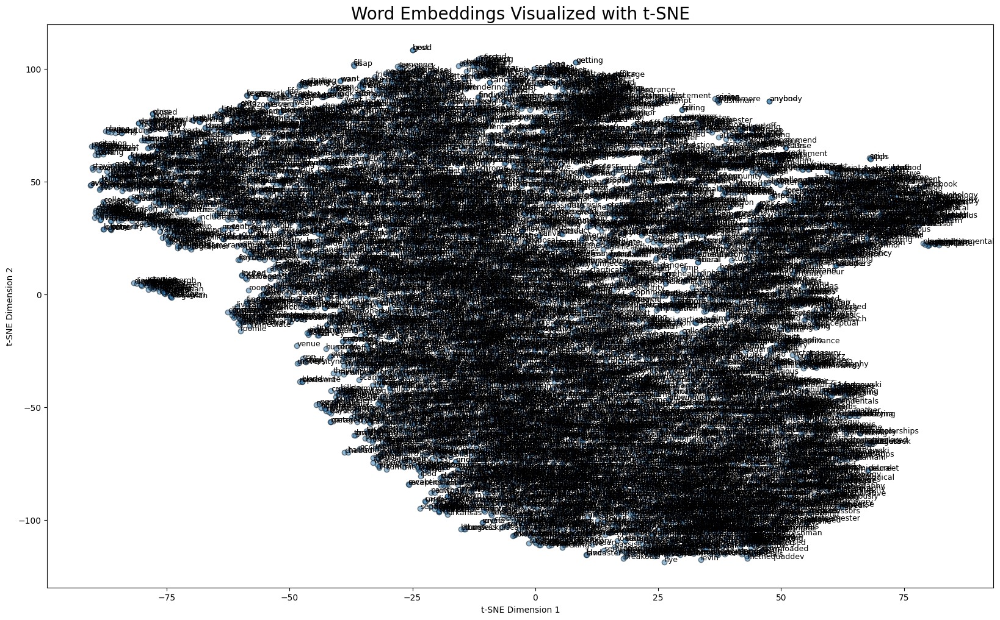

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

# Assuming 'model' is your loaded Word2Vec model
words = list(model.wv.index_to_key)  # All words in the model
word_vectors = np.array([model.wv[word] for word in words])  # Convert list to a NumPy array

# t-SNE transformation
tsne = TSNE(n_components=2, random_state=0, perplexity=30, n_iter=5000)  # Adjust perplexity and iterations if needed
word_vectors_2d = tsne.fit_transform(word_vectors)

# Plotting
plt.figure(figsize=(20, 12))
plt.scatter(word_vectors_2d[:, 0], word_vectors_2d[:, 1], edgecolor='k', alpha=0.5)
for i, word in enumerate(words):
    plt.text(word_vectors_2d[i, 0], word_vectors_2d[i, 1], word, fontsize=9)

plt.title('Word Embeddings Visualized with t-SNE', fontsize=20)
plt.xlabel('t-SNE Dimension 1')
plt.ylabel('t-SNE Dimension 2')
plt.show()

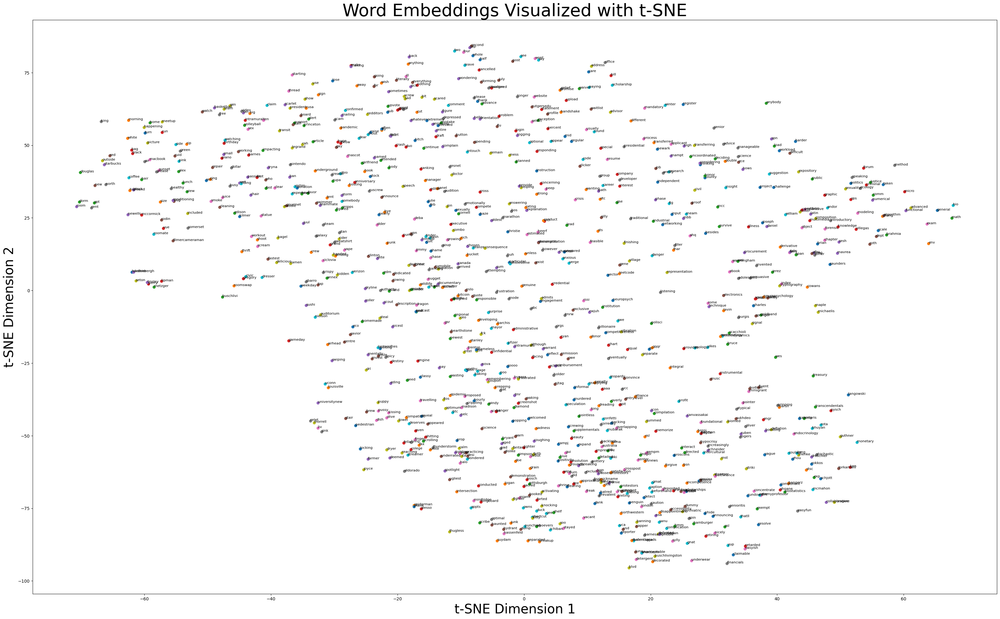

In [ ]:
# Assuming 'model' is your loaded Word2Vec model and 'words' are the words you want to visualize
word_vectors = np.array([model.wv[word] for word in words if word in model.wv])

# Increase the figure size and adjust the text size
plt.figure(figsize=(40, 24))

# t-SNE transformation with a higher perplexity and more iterations
tsne = TSNE(n_components=2, random_state=0, perplexity=40, n_iter=3000)
word_vectors_2d = tsne.fit_transform(word_vectors)

# Subsample to plot only a random subset of words to make the plot less cluttered
indices = np.arange(len(words))
np.random.shuffle(indices)
indices = indices[:1000]  # Adjust this number as needed
selected_words = [words[i] for i in indices]
selected_word_vectors_2d = word_vectors_2d[indices]

# Plotting with smaller text and without edge color for clarity
for i, word in enumerate(selected_words):
    plt.scatter(selected_word_vectors_2d[i, 0], selected_word_vectors_2d[i, 1])
    plt.annotate(word, xy=(selected_word_vectors_2d[i, 0], selected_word_vectors_2d[i, 1]), fontsize=8)

plt.title('Word Embeddings Visualized with t-SNE', fontsize=40)
plt.xlabel('t-SNE Dimension 1', fontsize=30)
plt.ylabel('t-SNE Dimension 2', fontsize=30)
plt.show()

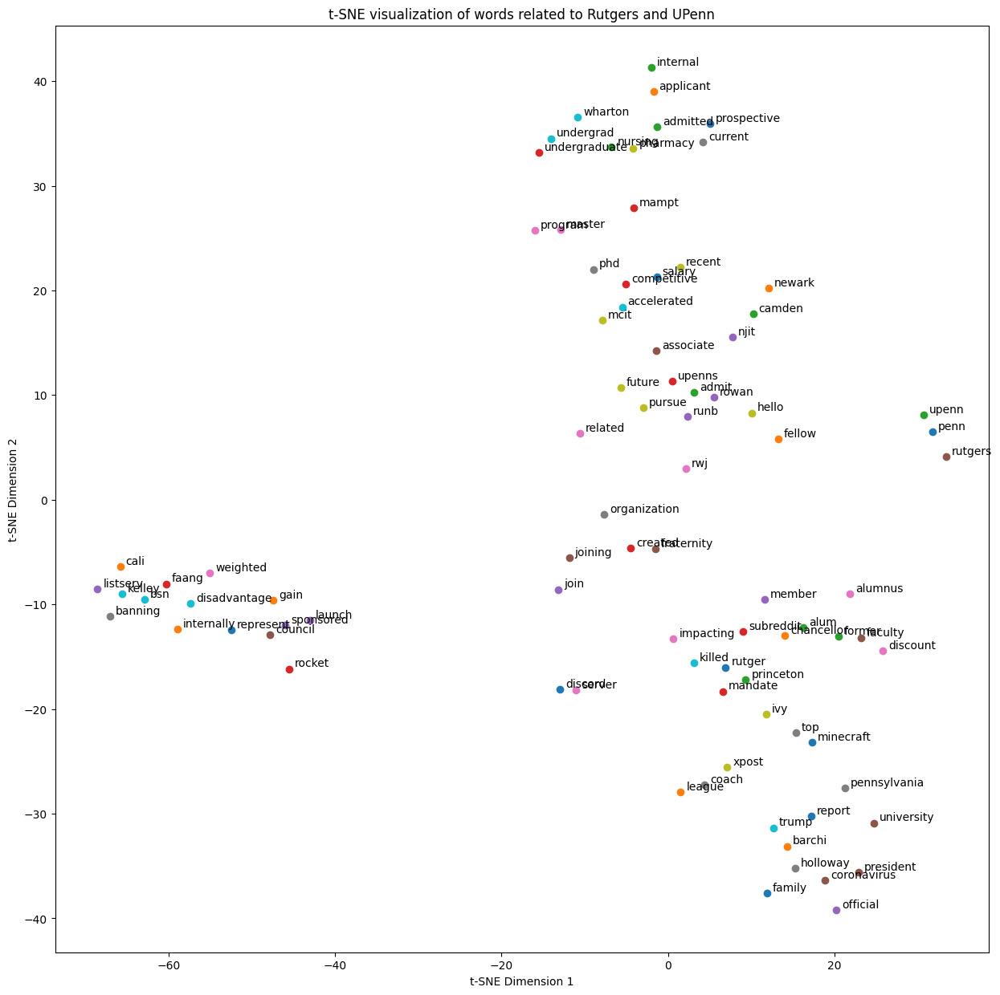

In [ ]:
import numpy as np
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

# Get top 50 words most similar to 'rutgers' and 'upenn' from the model
top_50_rutgers = [word for word, _ in model.wv.most_similar('rutgers', topn=50)]
top_50_upenn = [word for word, _ in model.wv.most_similar('upenn', topn=50)]

# Combine the words and ensure they are unique
unique_words = list(set(top_50_rutgers + top_50_upenn))

# Get the vectors for these words
word_vectors = np.array([model.wv[word] for word in unique_words if word in model.wv])

# Run t-SNE
tsne = TSNE(n_components=2, random_state=0, perplexity=5, n_iter=5000)
word_vectors_2d = tsne.fit_transform(word_vectors)

# Create the plot
plt.figure(figsize=(15, 15))
for i, word in enumerate(unique_words):
    x, y = word_vectors_2d[i, :]
    plt.scatter(x, y)
    plt.annotate(word, xy=(x, y), xytext=(5, 2), textcoords='offset points')

plt.title('t-SNE visualization of words related to Rutgers and UPenn')
plt.xlabel('t-SNE Dimension 1')
plt.ylabel('t-SNE Dimension 2')
plt.show()

3D t-SNE Visualization

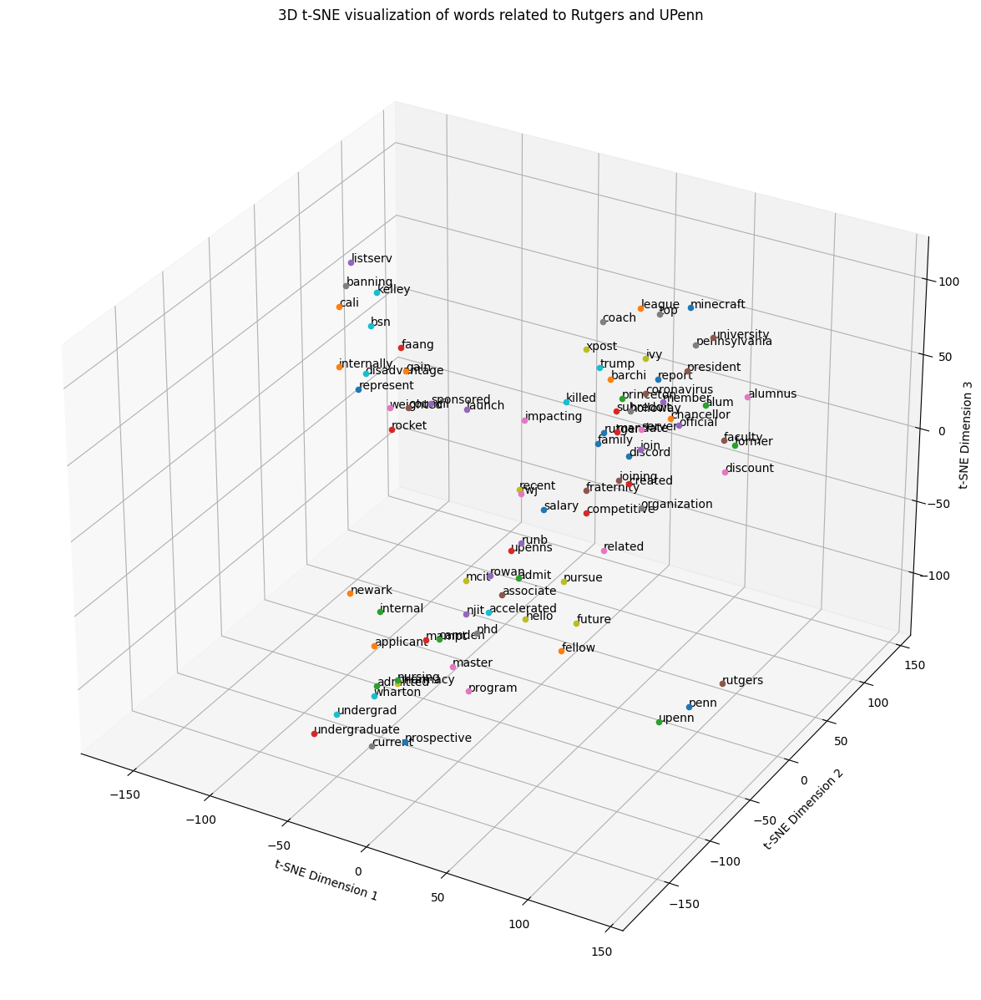

In [ ]:
from mpl_toolkits.mplot3d import Axes3D

# Run t-SNE with 3 components
tsne_3d = TSNE(n_components=3, random_state=0, perplexity=5, n_iter=5000)
word_vectors_3d = tsne_3d.fit_transform(word_vectors)

# Create the 3D plot
fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot
for i, word in enumerate(unique_words):
    ax.scatter(word_vectors_3d[i, 0], word_vectors_3d[i, 1], word_vectors_3d[i, 2])
    ax.text(word_vectors_3d[i, 0], word_vectors_3d[i, 1], word_vectors_3d[i, 2], word)

ax.set_title('3D t-SNE visualization of words related to Rutgers and UPenn')
ax.set_xlabel('t-SNE Dimension 1')
ax.set_ylabel('t-SNE Dimension 2')
ax.set_zlabel('t-SNE Dimension 3')
plt.show()

Animate the t-SNE Process (Pseudo-Animation)

/usr/local/lib/python3.10/dist-packages/matplotlib/animation.py:884: UserWarning: Animation was deleted without rendering anything. This is most likely not intended. To prevent deletion, assign the Animation to a variable, e.g. `anim`, that exists until you output the Animation using `plt.show()` or `anim.save()`.
  warnings.warn(


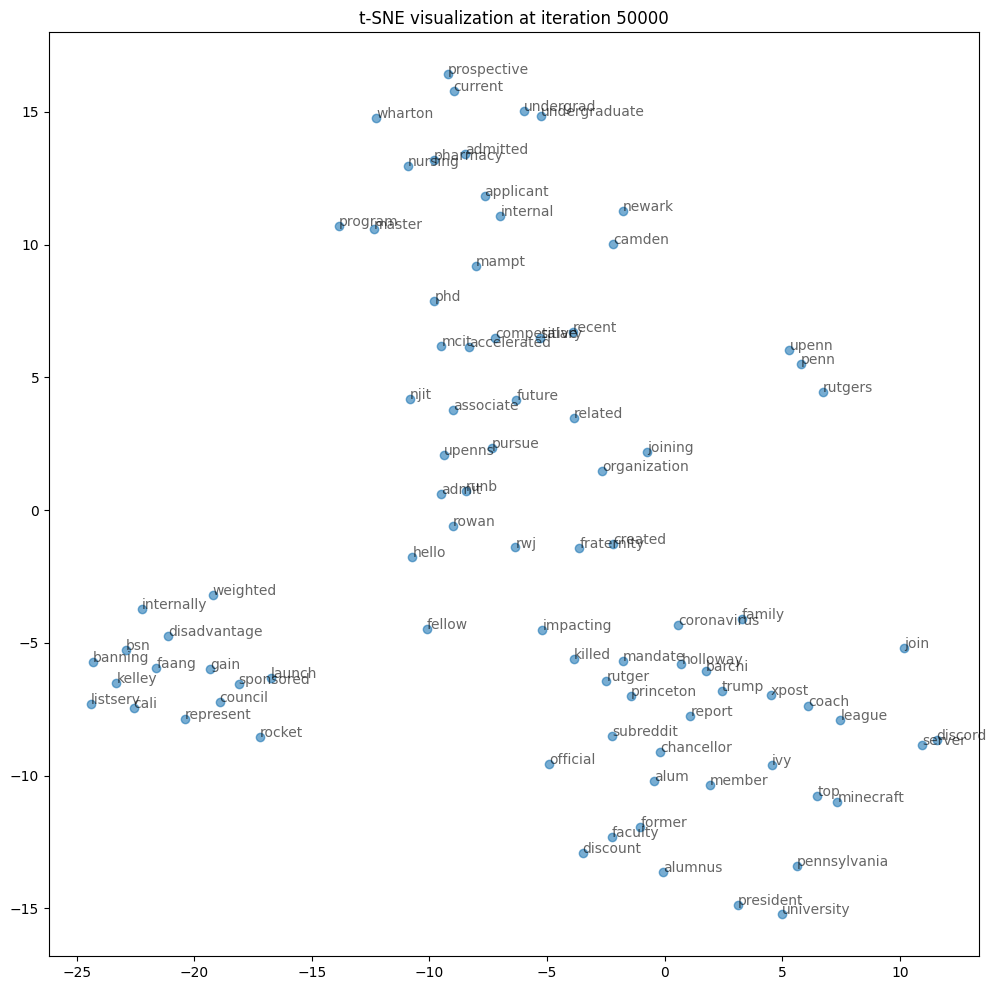

In [ ]:
%matplotlib inline
from matplotlib import pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

from matplotlib import animation

# We will run t-SNE multiple times, each time with more iterations

# Generate iterations from 250 to 50000, incrementing by 25
iterations = list(range(250, 50001, 50))

# Initialize figure
fig, ax = plt.subplots(figsize=(12, 12))

def animate(i):
    # Clear the previous scatter plot
    ax.clear()

    # Run t-SNE with the current number of iterations
    tsne_iter = TSNE(n_components=2, random_state=0, perplexity=10, n_iter=iterations[i])
    word_vectors_2d_iter = tsne_iter.fit_transform(word_vectors)

    # Plot the points and annotate
    ax.scatter(word_vectors_2d_iter[:, 0], word_vectors_2d_iter[:, 1], alpha=0.6)
    for idx, word in enumerate(unique_words):
        ax.annotate(word, (word_vectors_2d_iter[idx, 0], word_vectors_2d_iter[idx, 1]), alpha=0.6)

    # Set title with the current iteration
    ax.set_title(f't-SNE visualization at iteration {iterations[i]}')

# Create animation
ani = animation.FuncAnimation(fig, animate, frames=len(iterations), interval=1000, repeat=False)

#plt.show()
# Create and display the animation
ani = FuncAnimation(fig, animate, frames=len(iterations), interval=1000, repeat=False)

# Instead of plt.show(), use the HTML function to display the animation inline
HTML(ani.to_jshtml())

KeyboardInterrupt: 

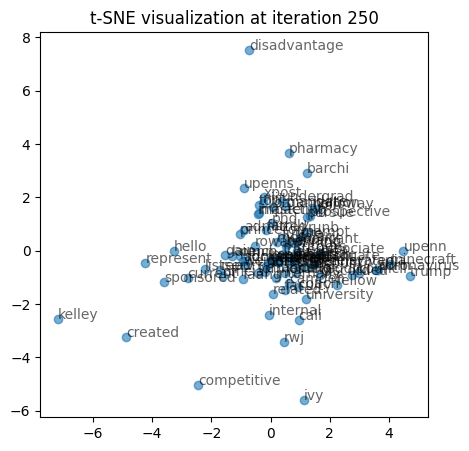

In [ ]:
%matplotlib inline
import numpy as np
from sklearn.manifold import TSNE
from matplotlib import pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Generate iterations from 250 to 50000, incrementing by 50
iterations = list(range(250, 50001, 50))

# Initialize figure
fig, ax = plt.subplots(figsize=(5, 5))

def animate(i):
    ax.clear()  # Clear the previous scatter plot
    tsne_iter = TSNE(n_components=2, random_state=0, perplexity=10, n_iter=iterations[i])
    word_vectors_2d_iter = tsne_iter.fit_transform(word_vectors)
    ax.scatter(word_vectors_2d_iter[:, 0], word_vectors_2d_iter[:, 1], alpha=0.6)
    for idx, word in enumerate(unique_words):
        ax.annotate(word, (word_vectors_2d_iter[idx, 0], word_vectors_2d_iter[idx, 1]), alpha=0.6)
    ax.set_title(f't-SNE visualization at iteration {iterations[i]}')

ani = FuncAnimation(fig, animate, frames=len(iterations), interval=1000, repeat=False)
HTML(ani.to_jshtml())

In [ ]:
# Assume constant n_iter for simplicity, vary perplexity
perplexities = range(5, 55, 10)  # Example: from 5 to 50 in steps of 5

def animate_perplexity(i):
    ax.clear()
    tsne_iter = TSNE(n_components=2, random_state=0, perplexity=perplexities[i], n_iter=1000)
    data_transformed = tsne_iter.fit_transform(word_vectors)
    ax.scatter(data_transformed[:, 0], data_transformed[:, 1], alpha=0.6)
    for idx, word in enumerate(unique_words):
        ax.annotate(word, (data_transformed[idx, 0], data_transformed[idx, 1]), alpha=0.6)
    ax.set_title(f't-SNE visualization with Perplexity {perplexities[i]}')

ani_perplexity = FuncAnimation(fig, animate_perplexity, frames=len(perplexities), interval=1000, repeat=False)
HTML(ani_perplexity.to_jshtml())

# Convert NB to HTML

In [ ]:
!pip install nbconvert

In [ ]:
!jupyter nbconvert --to html '/content/drive/MyDrive/Projects /ML for DS/reddit_nlp.ipynb'

[NbConvertApp] Converting notebook /content/drive/MyDrive/Projects /ML for DS/reddit_nlp.ipynb to html
[NbConvertApp] Writing 2922565 bytes to /content/drive/MyDrive/Projects /ML for DS/reddit_nlp.html
